In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import datasets,transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from torchsummary import summary
torch.manual_seed(0) # Set for testing purposes, please do not change!

In [2]:
DATA_DIR = "D:/Kaggle/deep-learning/generative-dog-images/data/all-dogs-parent/"
RESULTS_DIR = "D:/Kaggle/deep-learning/generative-dog-images/wgan-v1-outputs/"
CHK_PTS_DIR = "D:/Kaggle/deep-learning/generative-dog-images/checkpoints/"

In [3]:
batch_size = 64
image_size = 64

#apply augmentations on the images and Resize and center crop them
#Normalize images to -1, 1 range
random_transforms = [transforms.ColorJitter(), transforms.RandomRotation(degrees=20)]
transform = transforms.Compose([transforms.Resize(64),
                                transforms.CenterCrop(64),
                                transforms.RandomHorizontalFlip(p=0.5),
                                transforms.RandomApply(random_transforms, p=0.2),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

train_data = datasets.ImageFolder(DATA_DIR, transform=transform)
dataloader = torch.utils.data.DataLoader(train_data, shuffle=True,
                                           batch_size=batch_size)
                                           
imgs, label = next(iter(dataloader))
imgs = imgs.numpy().transpose(0, 2, 3, 1)

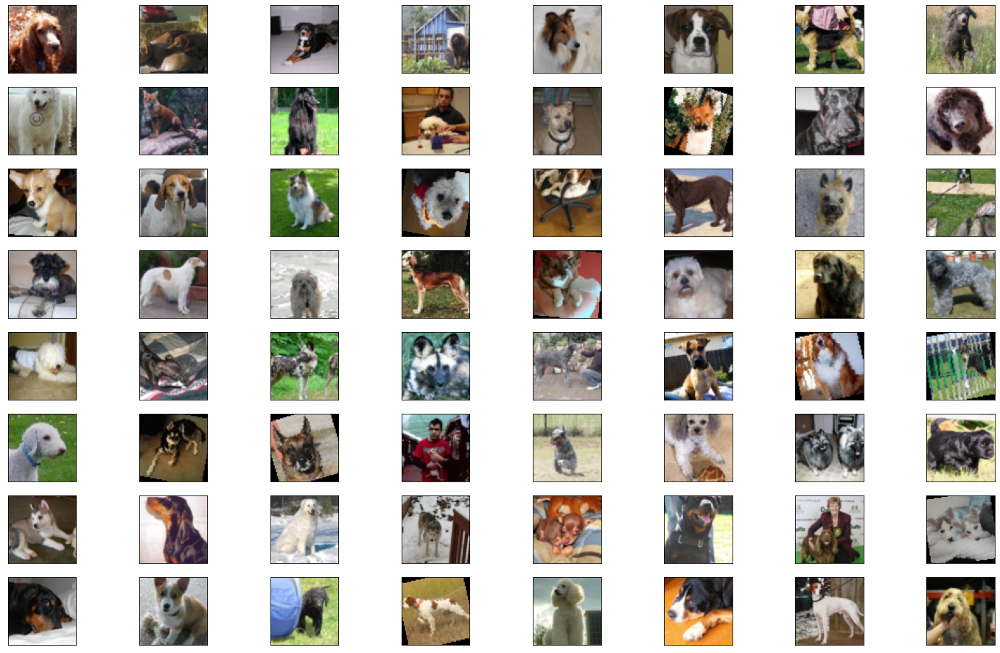

In [4]:
fig = plt.figure(figsize=(25, 16))
for ii, img in enumerate(imgs):
    ax = fig.add_subplot(8, 8, ii + 1, xticks=[], yticks=[])
    
    plt.imshow((img+1.)/2.)

In [5]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()
    
def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

In [6]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        '''
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )
        '''
        self.gen = nn.Sequential(
                nn.ConvTranspose2d(100, 512, 4, stride=1, padding=0),
                nn.BatchNorm2d(512),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
                nn.BatchNorm2d(128),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
                nn.BatchNorm2d(64),
                nn.ReLU(inplace=True),
                nn.ConvTranspose2d(64, im_chan, 4, stride=2, padding=1),
                nn.Tanh()
                )
    '''
    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )
    '''
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)
    
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [7]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=3, hidden_dim=64):
        super(Critic, self).__init__()
        '''
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )
        '''
        self.crit = nn.Sequential(
                nn.Conv2d(im_chan, 64, 4, stride=2, padding=1),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(64, 128, 4, stride=2, padding=1),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(128, 256, 4, stride=2, padding=1),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(256, 512, 4, stride=2, padding=1),
                nn.BatchNorm2d(512),
                nn.LeakyReLU(0.2, inplace=True),
                nn.Conv2d(512, 1, 3, stride=2, padding=0),
                )
        
    '''
    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )
    '''
    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

In [8]:
n_epochs = 100
z_dim = 100
display_step = 50
batch_size = 64
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 3
device = 'cuda'

In [9]:
gen = Generator(z_dim).to(device)
#print(gen)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
#print(crit)

crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

In [10]:
summary(gen, (100,))
summary(crit, (3,64,64))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,712
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,408
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,416
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,136
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,075
             Tanh-14            [-1, 3,

In [11]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    #print(real.shape)
    #print(fake.shape)
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    #print("ms",mixed_scores.shape)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient

In [12]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    #print(gradient.shape)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 3, 64, 64))
print("Success!")

Success!


In [13]:
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [14]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 3, 64, 64))
print("Success!")

Success!


In [15]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1. * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [16]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


In [17]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [18]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


In [22]:
CHK_PT = "D:/Kaggle/deep-learning/generative-dog-images/checkpoints/wgan-v1.pt"

checkpoint = torch.load(CHK_PT)
gen.load_state_dict(checkpoint['gen_state_dict'])
crit.load_state_dict(checkpoint['crit_state_dict'])
gen_opt.load_state_dict(checkpoint['gen_optimizer_state_dict'])
crit_opt.load_state_dict(checkpoint['crit_optimizer_state_dict'])
epoch = checkpoint['epoch']
errG = checkpoint['gen_loss']
errD = checkpoint['crit_loss']


Step 50: Generator loss: -23.60847445487976, critic loss: -14.784712586005528


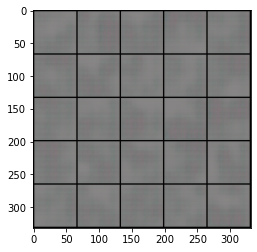

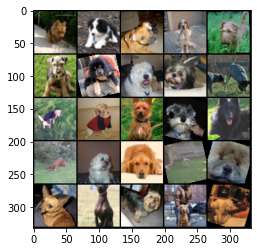

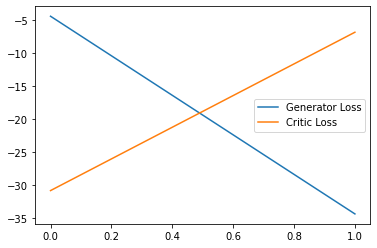

Step 100: Generator loss: -32.00772974014282, critic loss: -9.270672823588054


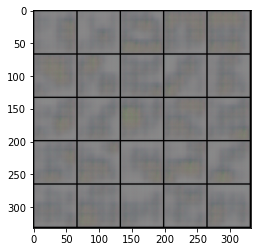

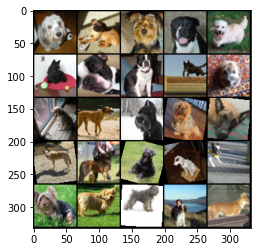

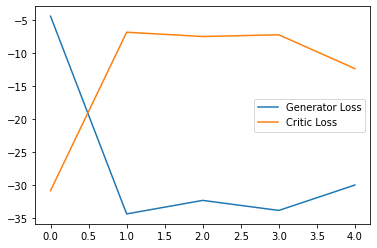

Step 150: Generator loss: -29.39102614402771, critic loss: -10.173182236353554


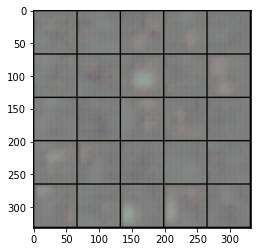

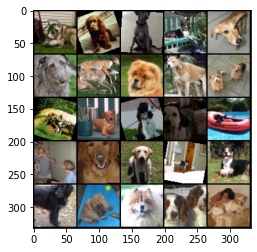

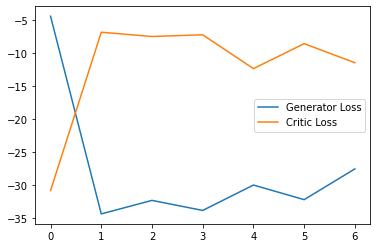

Step 200: Generator loss: -40.13194877624512, critic loss: -5.156682399511336


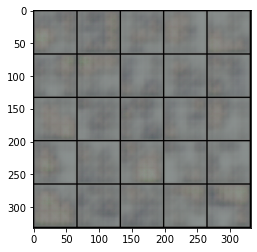

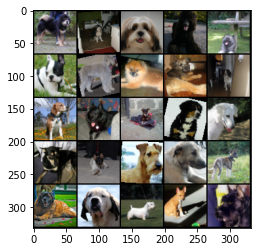

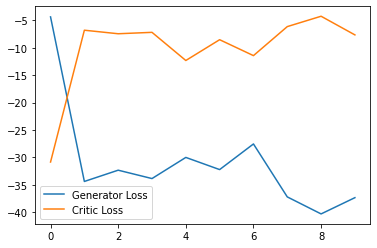

Step 250: Generator loss: -35.177947969436644, critic loss: -10.249439051151274


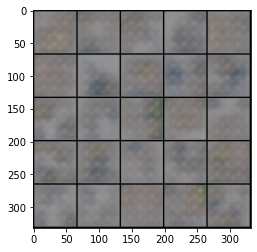

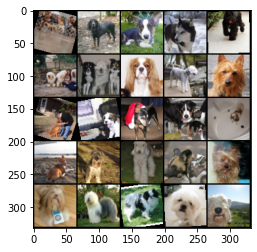

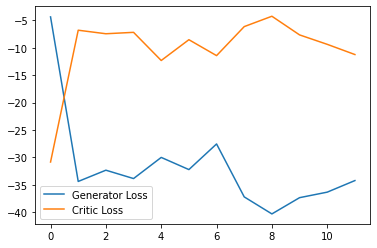

Step 300: Generator loss: -37.712161178588865, critic loss: -12.288095719019573


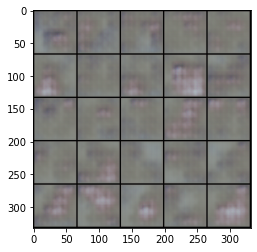

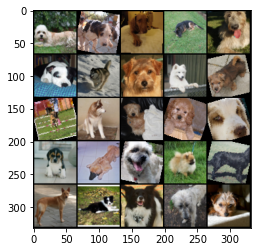

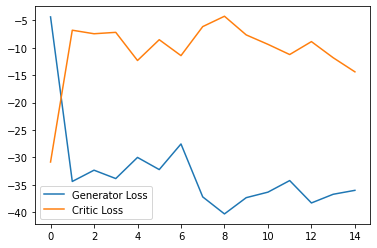

Step 350: Generator loss: -36.78400481700897, critic loss: -15.678489972750345


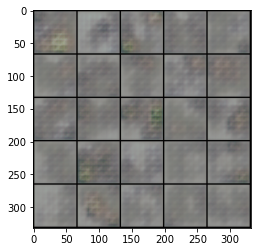

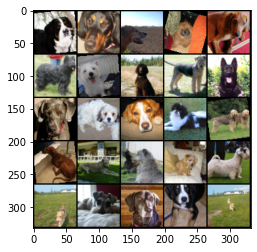

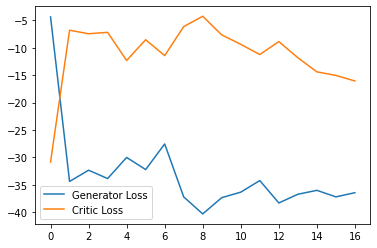

Step 400: Generator loss: -38.168319692611696, critic loss: -16.656285912195838


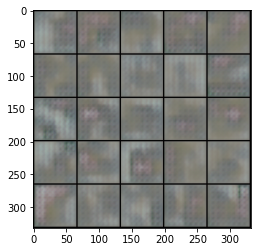

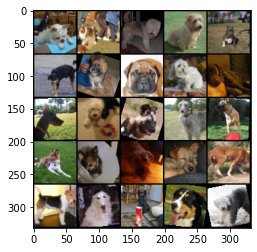

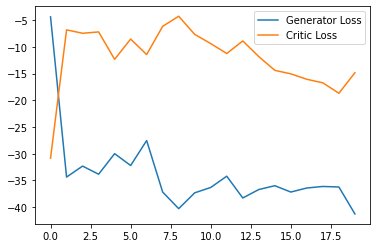

Step 450: Generator loss: -44.015772857666015, critic loss: -16.445630321502687


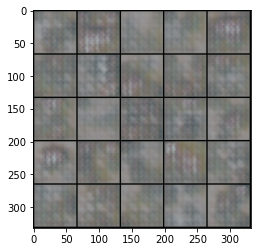

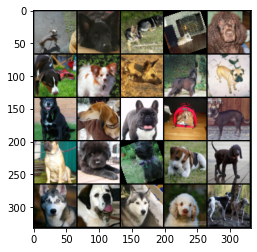

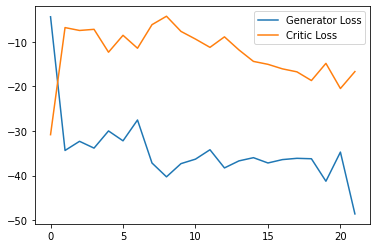

Step 500: Generator loss: -38.90052940368653, critic loss: -16.408799630800882


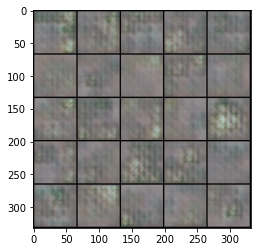

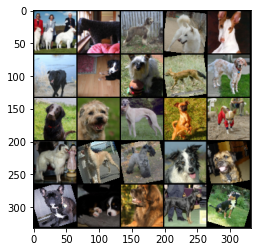

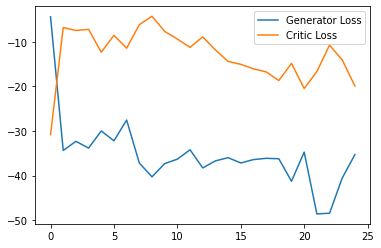

Step 550: Generator loss: -27.416721910238266, critic loss: -35.76792122205098


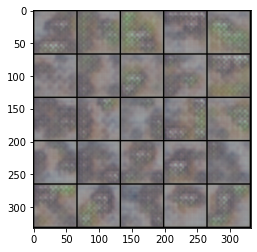

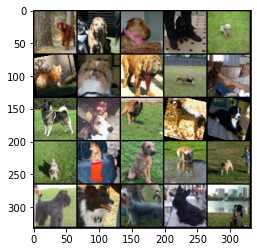

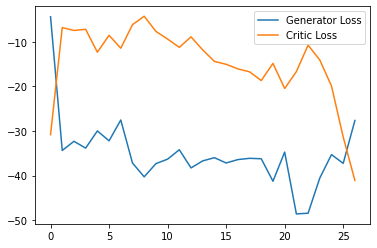

Step 600: Generator loss: -10.710236403718591, critic loss: -12.507151077191036


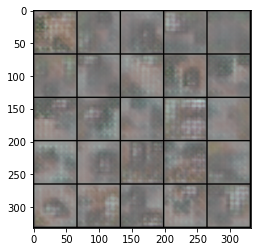

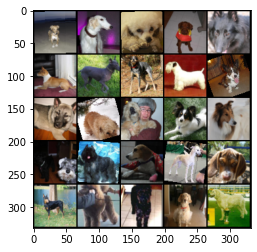

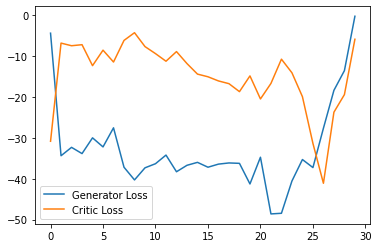

Step 650: Generator loss: 6.957920358181, critic loss: -9.764129837354027


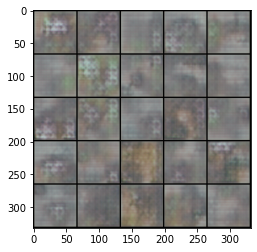

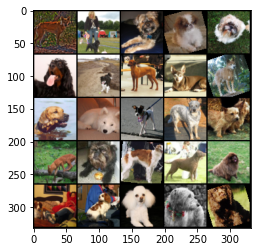

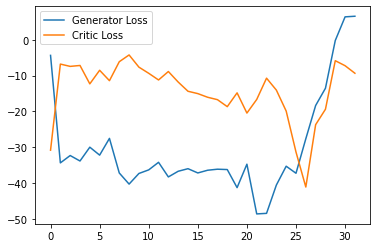

Step 700: Generator loss: 11.170673456192016, critic loss: -10.073567978541057


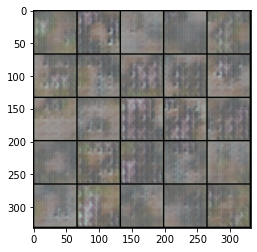

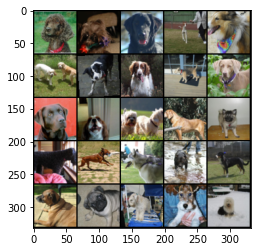

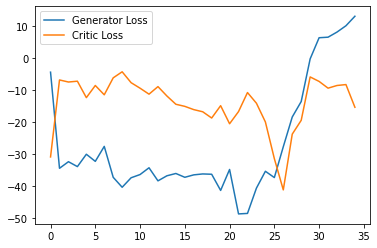

Step 750: Generator loss: 13.649894981384277, critic loss: -10.023071336547533


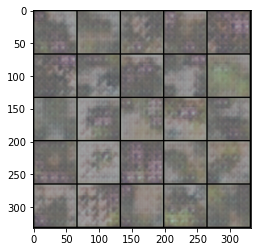

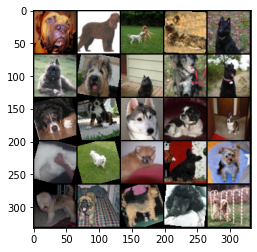

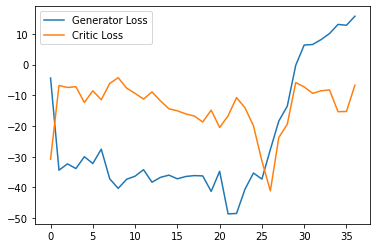

Step 800: Generator loss: 15.389523830413818, critic loss: -4.433026644388833


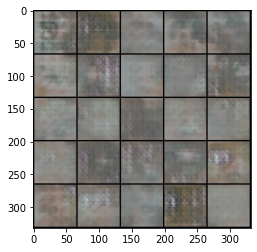

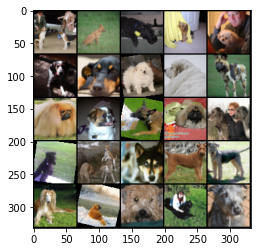

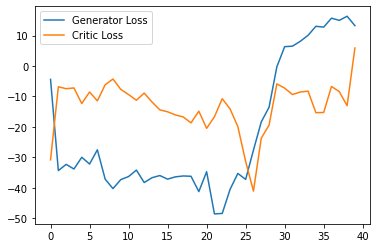

Step 850: Generator loss: 12.104794712066651, critic loss: -0.6166490419705708


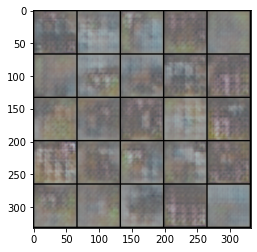

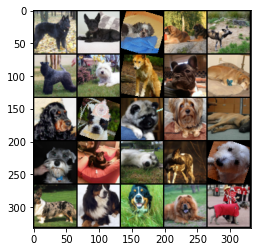

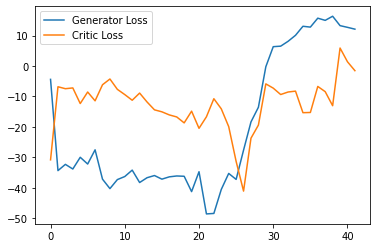

Step 900: Generator loss: 9.864784154891968, critic loss: -2.6903642276922866


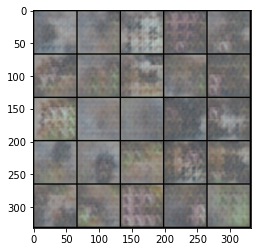

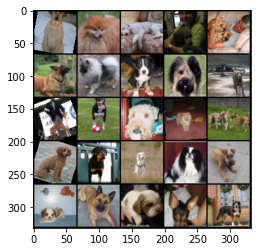

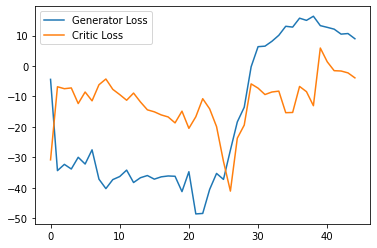

Step 950: Generator loss: 5.262801381349564, critic loss: -3.8929775083065055


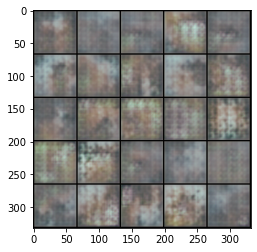

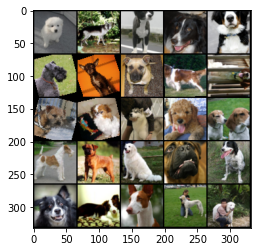

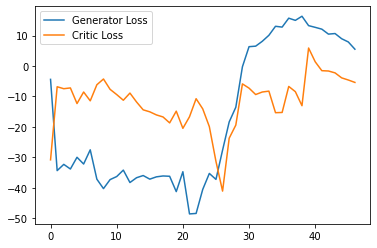

Step 1000: Generator loss: 1.280503865480423, critic loss: -1.7594549682736391


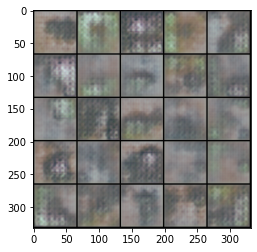

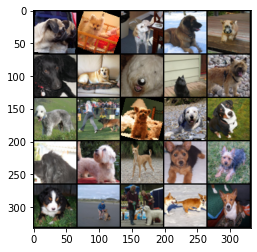

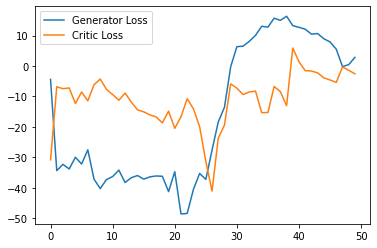

Step 1050: Generator loss: 1.042315625399351, critic loss: -3.708579567273458


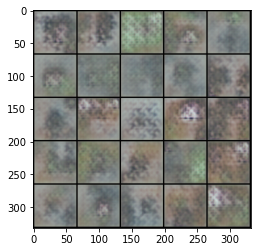

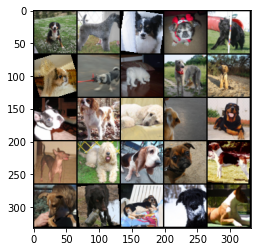

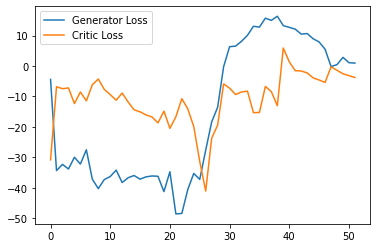

Step 1100: Generator loss: 4.095164440274239, critic loss: -11.658621800740555


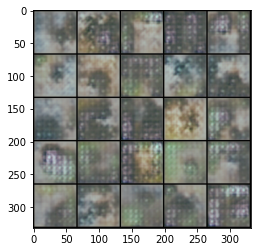

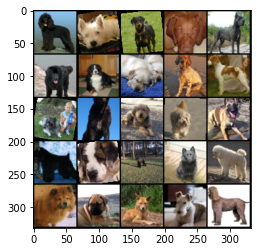

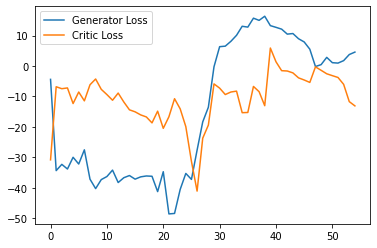

Step 1150: Generator loss: 4.408734449148178, critic loss: -13.068890565236407


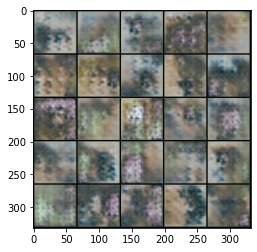

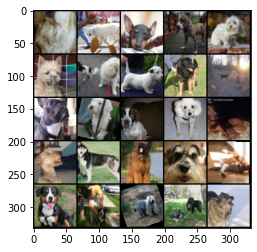

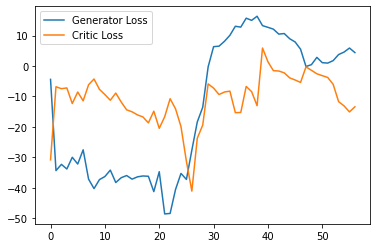

Step 1200: Generator loss: 1.665684205889702, critic loss: -10.515209961732229


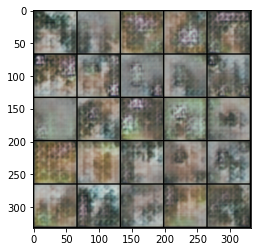

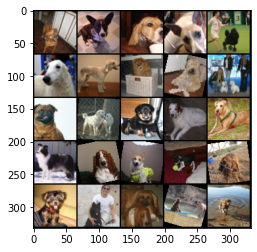

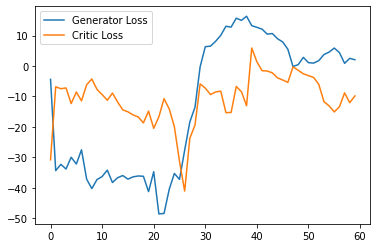

Step 1250: Generator loss: 1.334152585864067, critic loss: -12.395193146069847


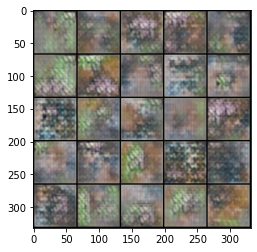

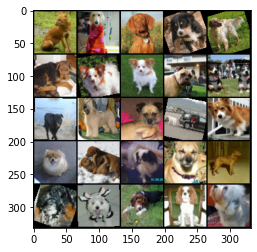

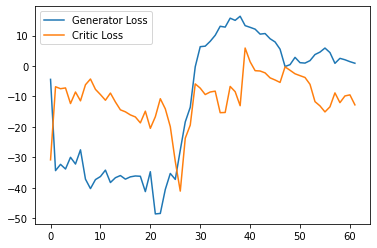

Step 1300: Generator loss: -2.2076124918460844, critic loss: -2.3944356306393946


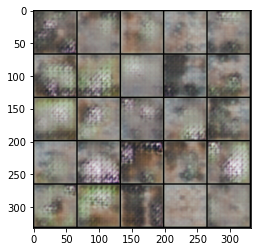

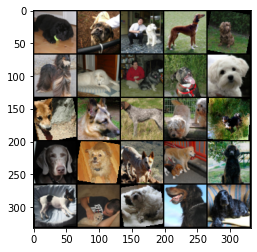

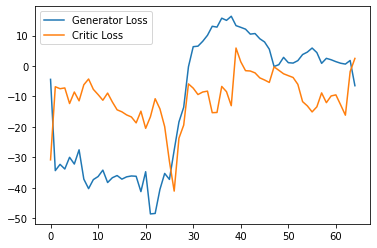

Step 1350: Generator loss: -12.905746269226075, critic loss: -1.9399160576860113


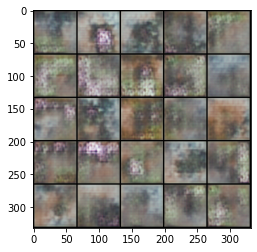

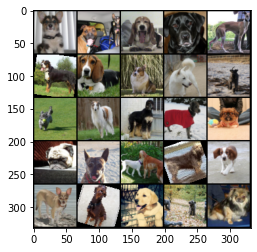

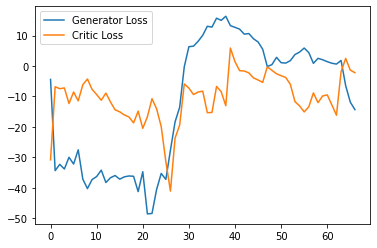

Step 1400: Generator loss: -10.559499816894531, critic loss: -2.409683055082956


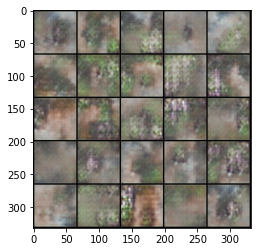

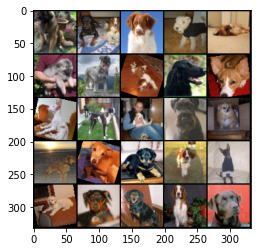

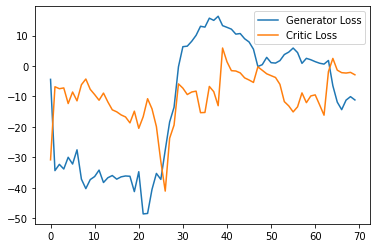

Step 1450: Generator loss: -12.976433639526368, critic loss: -3.0977943038940436


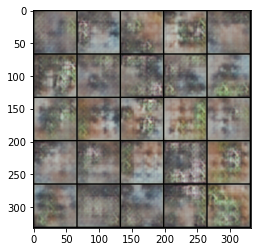

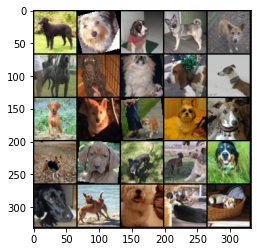

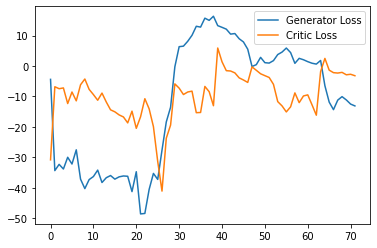

Step 1500: Generator loss: -10.656096894741058, critic loss: -7.1435910638173405


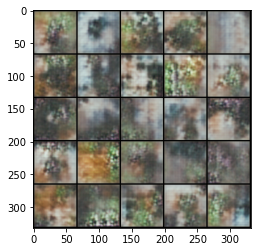

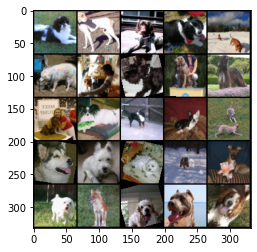

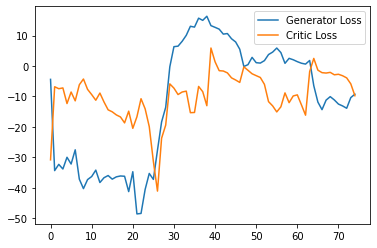

Step 1550: Generator loss: -7.565983822345734, critic loss: -5.757990473310152


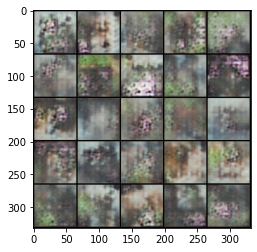

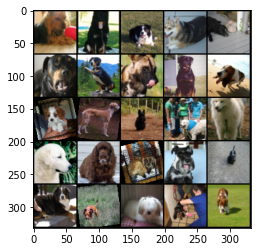

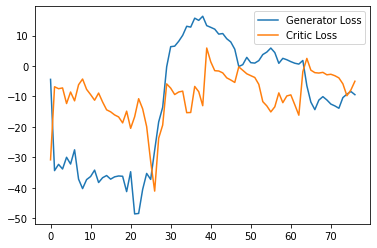

Step 1600: Generator loss: -5.032225315570831, critic loss: -10.018889831701912


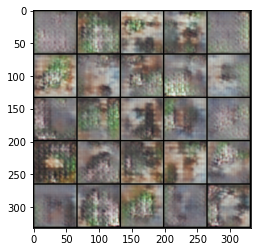

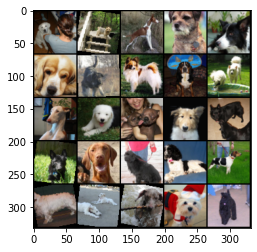

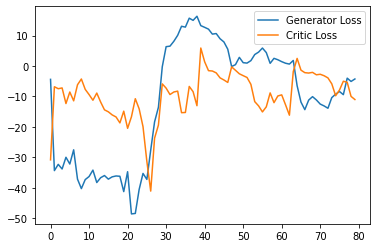

Step 1650: Generator loss: -8.479078109264373, critic loss: -3.670363845427832


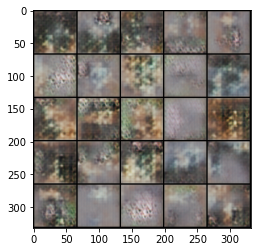

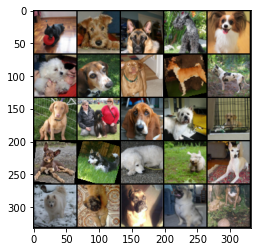

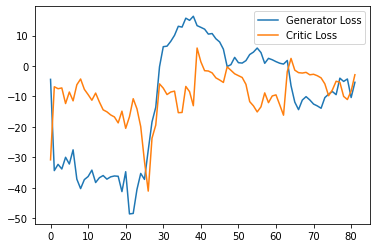

Step 1700: Generator loss: -20.718982009887696, critic loss: -1.0261108378569284


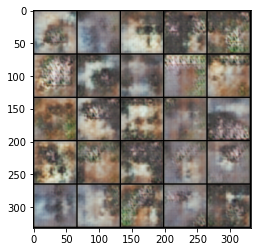

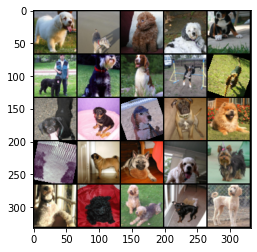

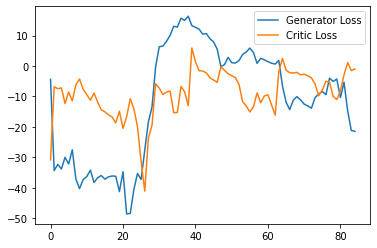

Step 1750: Generator loss: -15.628552436828613, critic loss: -1.6938246178627014


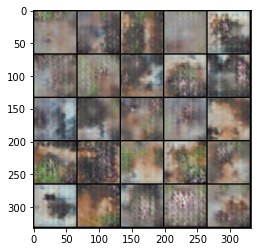

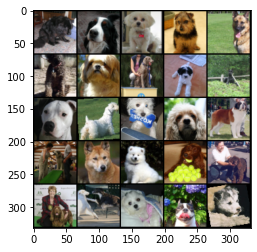

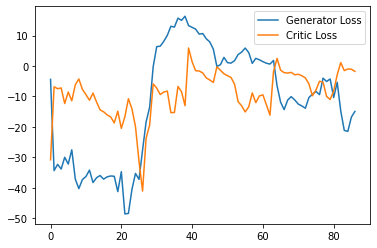

Step 1800: Generator loss: -18.484887924194336, critic loss: -2.963166695435843


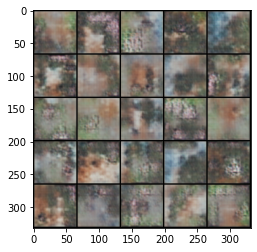

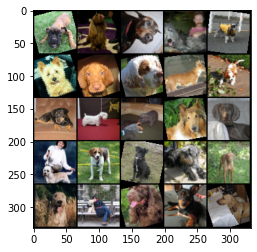

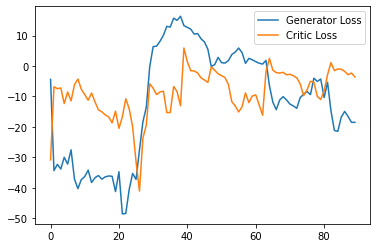

Step 1850: Generator loss: -17.735753803253175, critic loss: -6.588023861249287


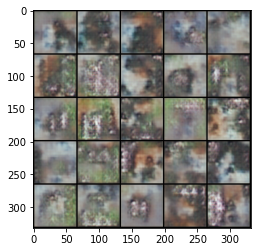

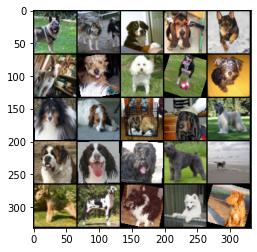

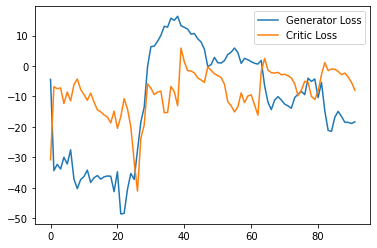

Step 1900: Generator loss: -15.362528085708618, critic loss: -6.44303565710783


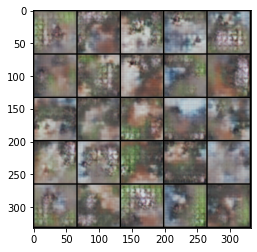

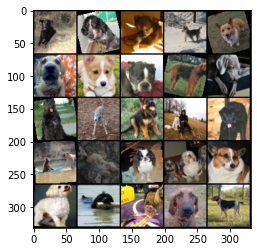

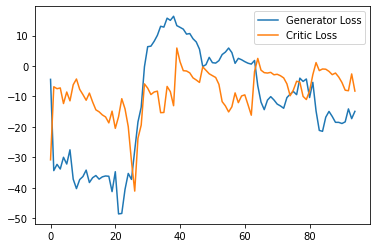

Step 1950: Generator loss: -9.971470603048802, critic loss: -4.374754721522331


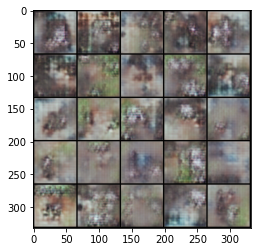

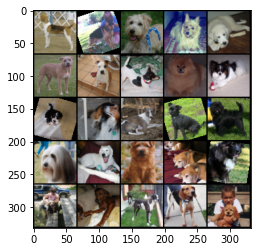

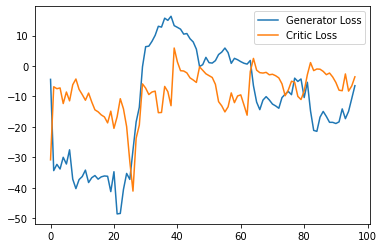

Step 2000: Generator loss: -11.434554586410522, critic loss: -5.731826518376669


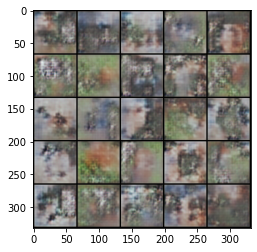

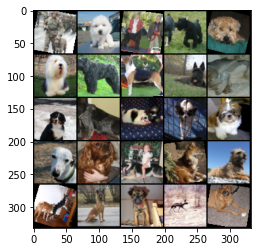

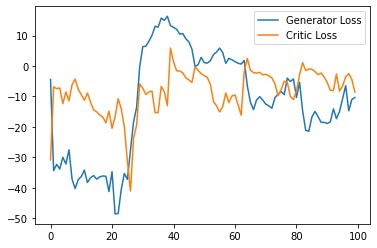

Step 2050: Generator loss: -16.708125123977663, critic loss: -3.0940575230618315


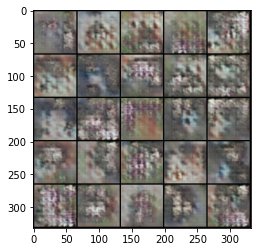

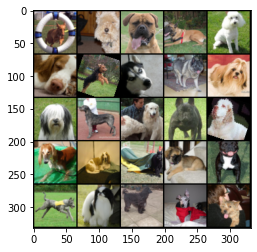

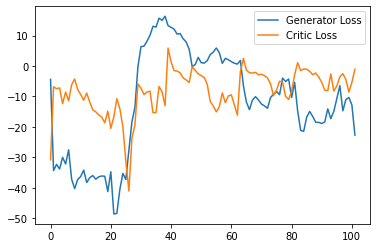

Step 2100: Generator loss: -15.971747207641602, critic loss: -4.466283030112584


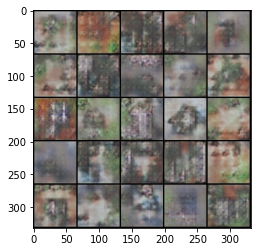

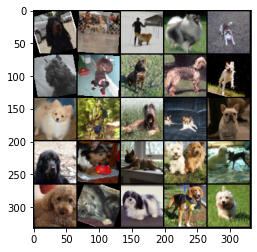

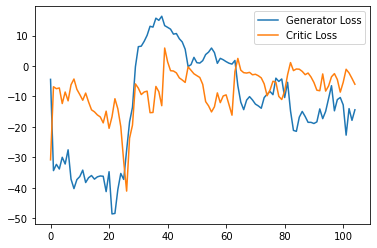

Step 2150: Generator loss: -11.068240957260132, critic loss: -6.815041773716608


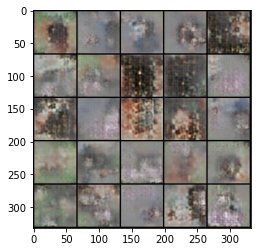

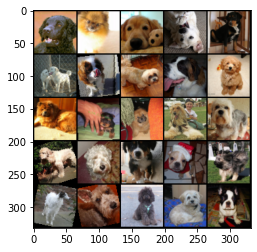

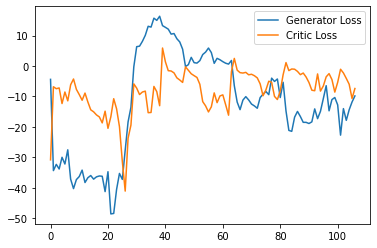

Step 2200: Generator loss: -17.502273044586182, critic loss: -1.569283062517643


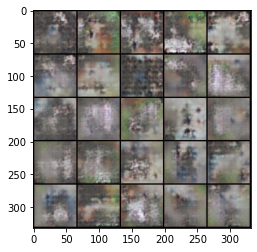

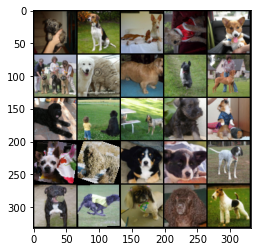

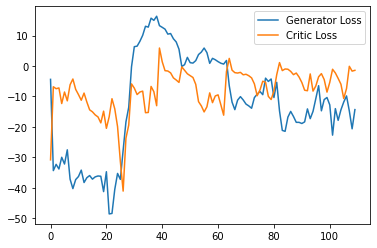

Step 2250: Generator loss: -13.970280730724335, critic loss: -7.309405425389608


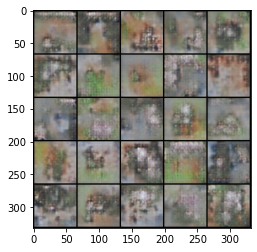

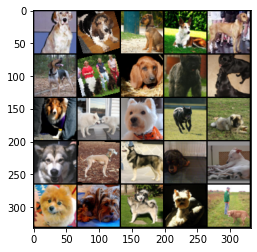

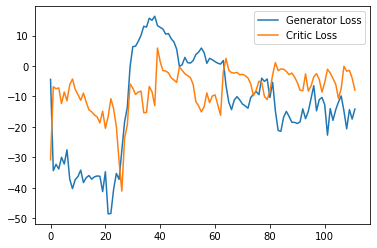

Step 2300: Generator loss: -14.722759566307069, critic loss: -3.1974586633841193


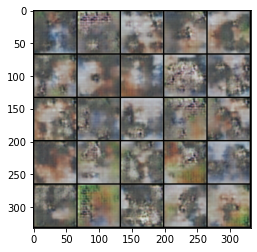

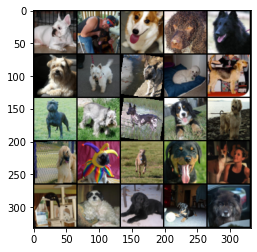

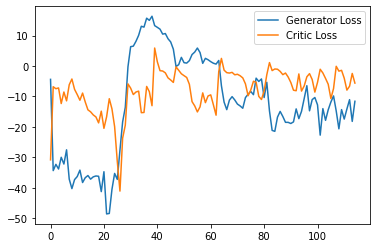

Step 2350: Generator loss: -11.419547976255418, critic loss: 0.19463373363018072


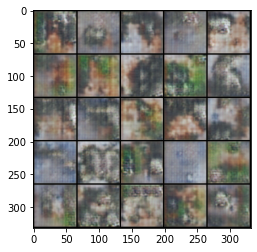

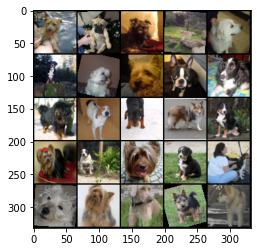

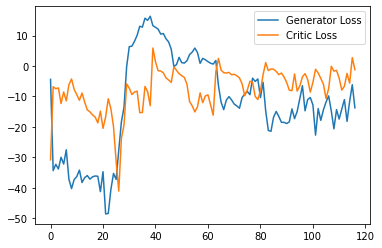

Step 2400: Generator loss: -15.943510208129883, critic loss: -1.603334079583486


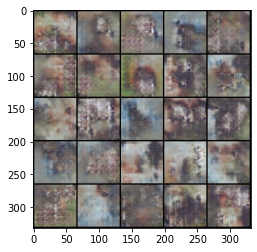

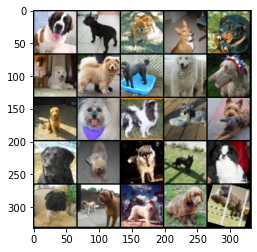

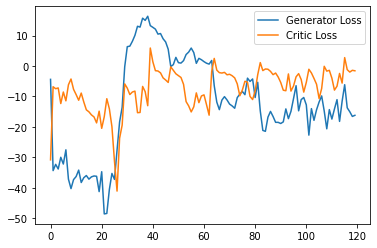

Step 2450: Generator loss: -14.553491497039795, critic loss: -2.6140646481513965


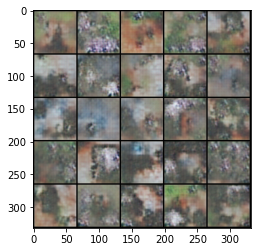

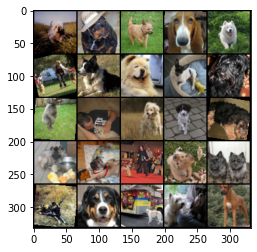

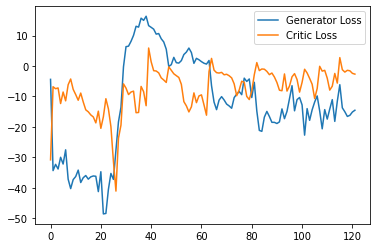

Step 2500: Generator loss: -13.766550769805908, critic loss: -3.729553662935893


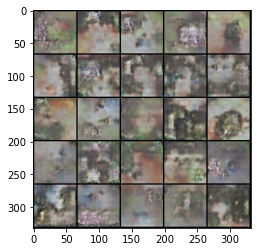

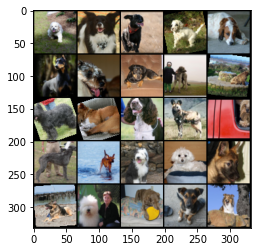

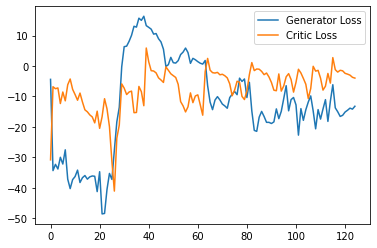

Step 2550: Generator loss: -12.007471799850464, critic loss: -5.521993187268574


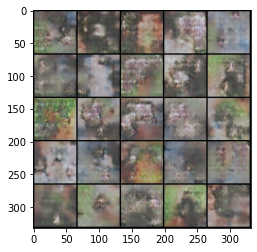

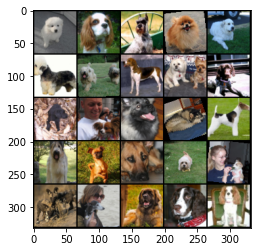

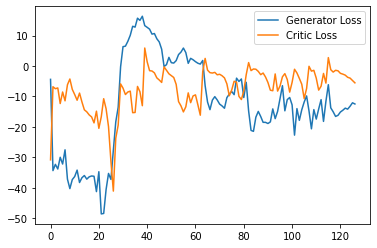

Step 2600: Generator loss: -10.722745634019375, critic loss: -7.883831461270651


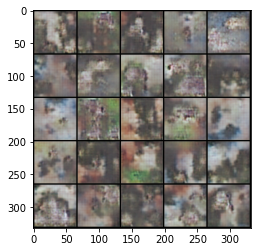

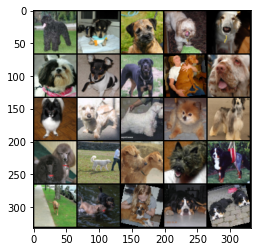

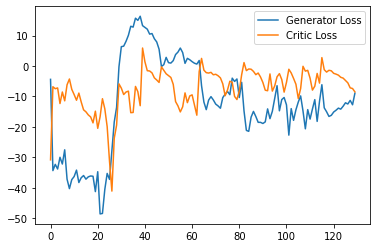

Step 2650: Generator loss: -14.284619007110596, critic loss: -1.1625102291504539


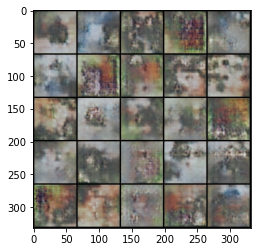

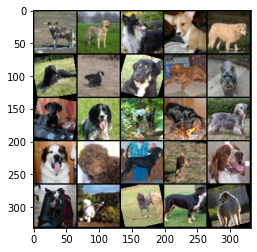

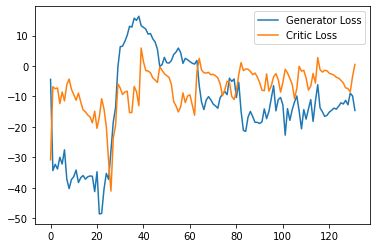

Step 2700: Generator loss: -16.760857791900634, critic loss: -0.5907780548930167


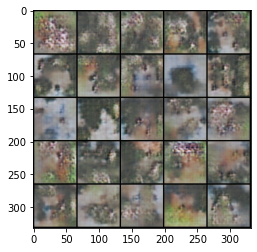

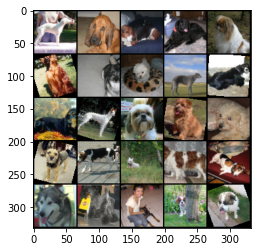

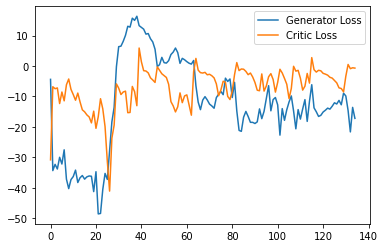

Step 2750: Generator loss: -16.195503616333006, critic loss: -0.7239462508757909


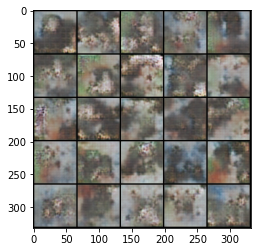

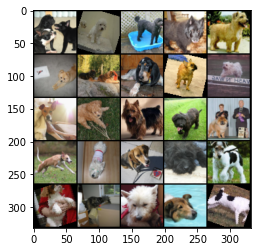

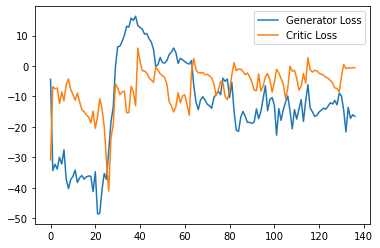

Step 2800: Generator loss: -15.416368751525878, critic loss: -1.6725004714230696


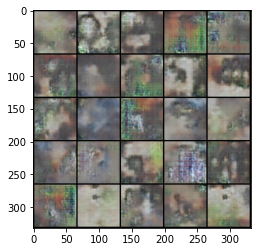

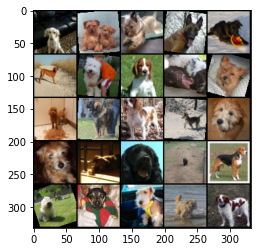

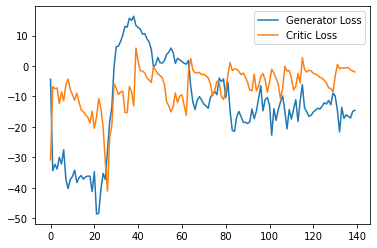

Step 2850: Generator loss: -14.68313087463379, critic loss: -4.883567009766896


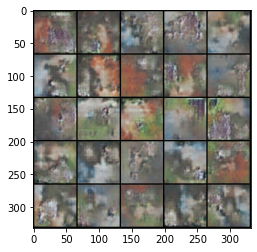

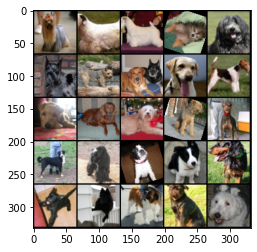

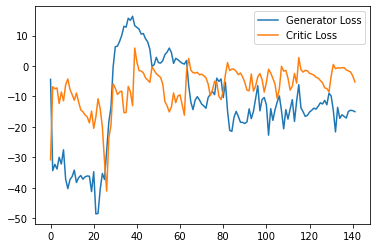

Step 2900: Generator loss: -14.37274471282959, critic loss: -5.208390035430592


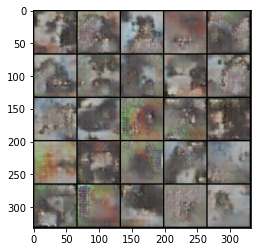

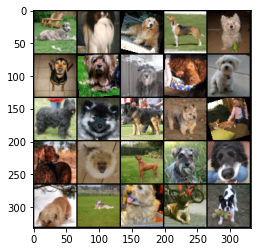

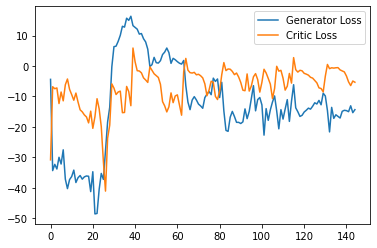

Step 2950: Generator loss: -12.639395247101783, critic loss: -8.52985329707464


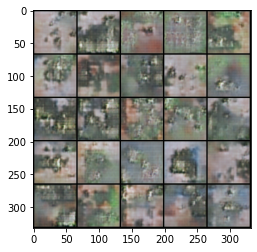

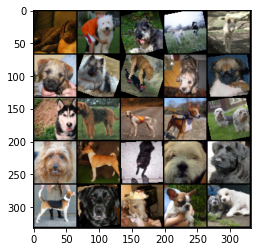

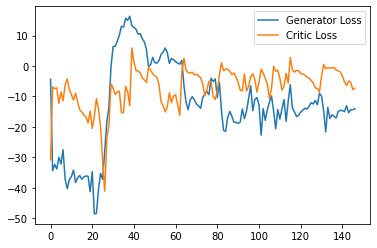

Step 3000: Generator loss: -13.186165242195129, critic loss: -3.3786583834886543


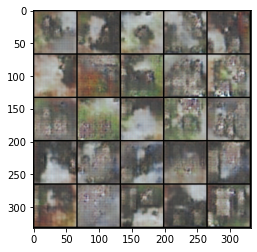

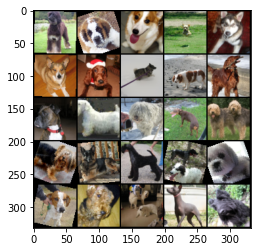

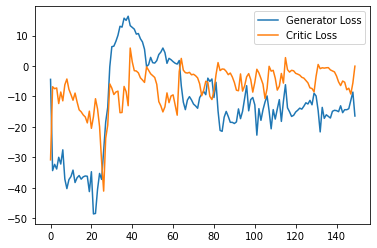

Step 3050: Generator loss: -14.951718521118163, critic loss: -2.7351147143046064


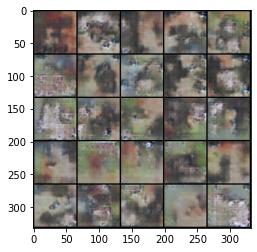

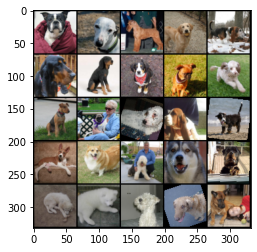

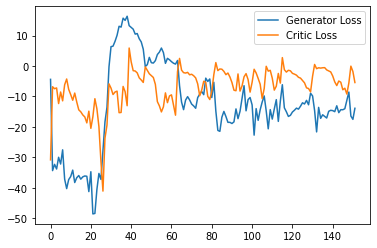

Step 3100: Generator loss: -15.871113103628158, critic loss: -2.9505165424942965


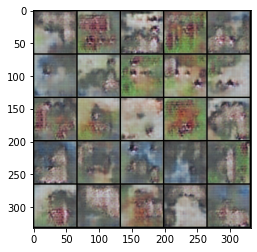

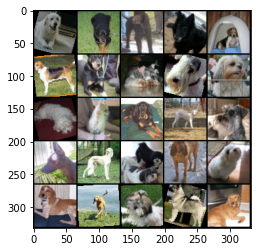

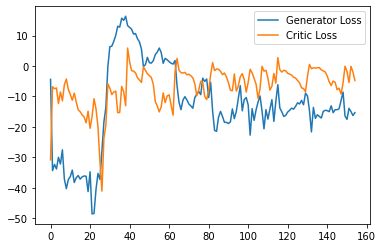

Step 3150: Generator loss: -5.202244693040848, critic loss: 9.813723737398783


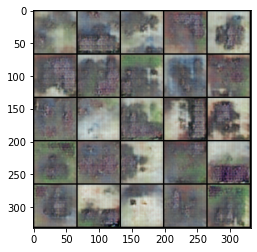

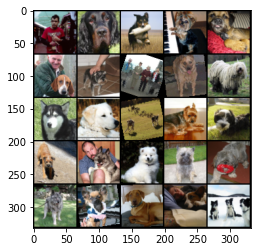

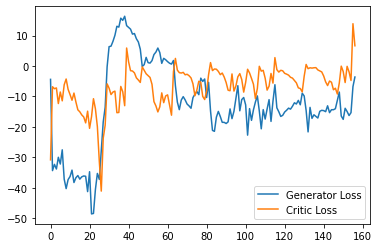

Step 3200: Generator loss: -8.76855357170105, critic loss: 0.14839722057183605


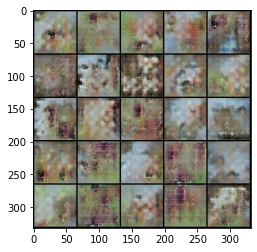

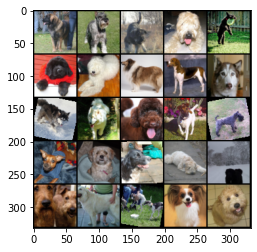

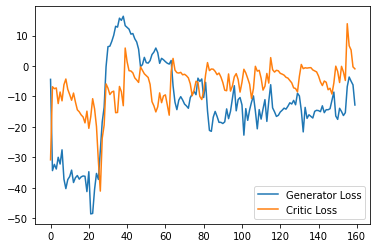

Step 3250: Generator loss: -15.360931148529053, critic loss: -1.087084558705489


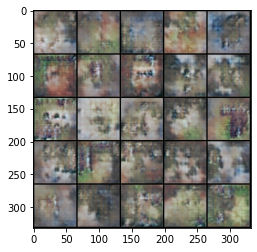

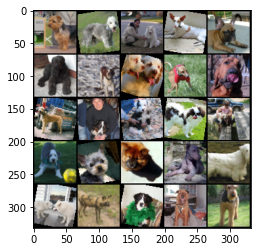

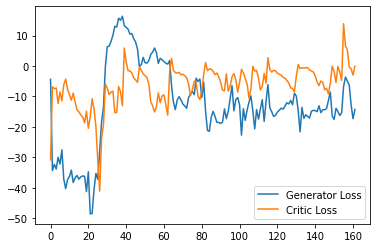

Step 3300: Generator loss: -13.893715133666992, critic loss: -0.17907697036862374


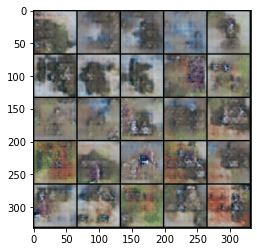

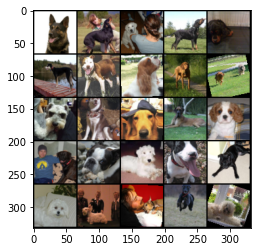

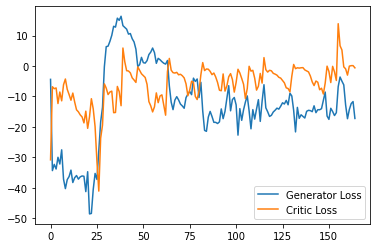

Step 3350: Generator loss: -14.245569229125977, critic loss: -0.3072553786635398


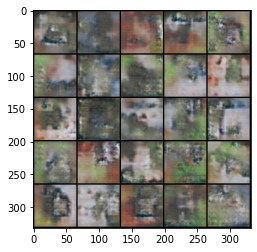

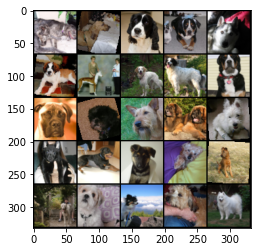

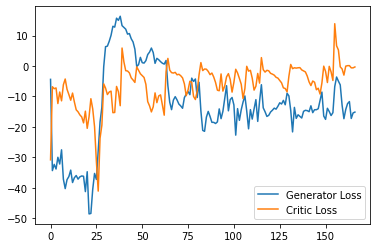

Step 3400: Generator loss: -14.270568237304687, critic loss: -0.09601842174927387


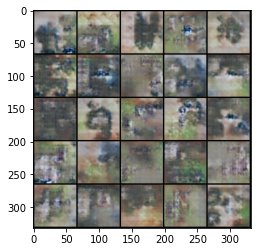

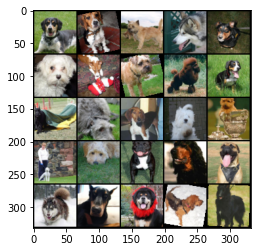

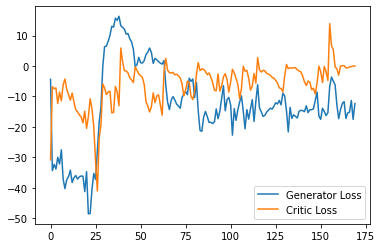

Step 3450: Generator loss: -13.433057441711426, critic loss: -0.0033533784747123863


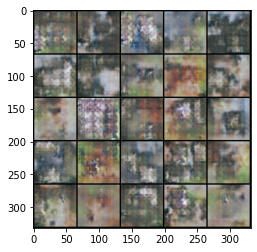

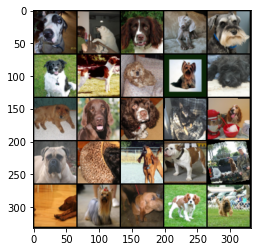

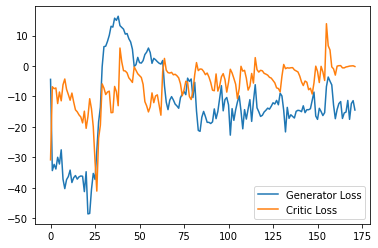

Step 3500: Generator loss: -11.52460163116455, critic loss: 0.06740681966145837


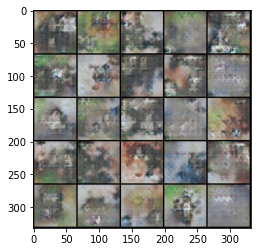

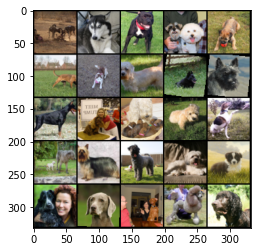

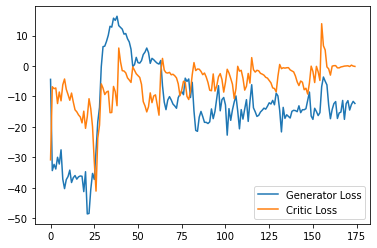

Step 3550: Generator loss: -17.008436889648436, critic loss: 0.05652784009774527


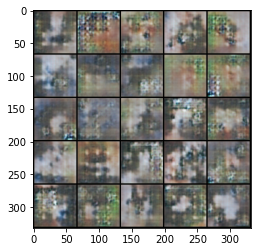

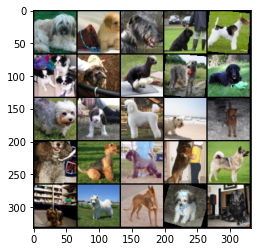

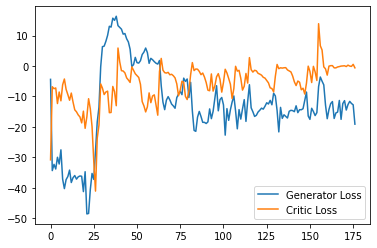

Step 3600: Generator loss: -13.996928424835206, critic loss: -0.10491506765286127


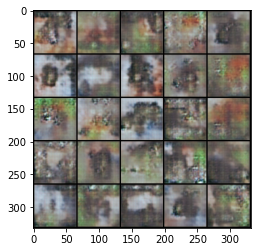

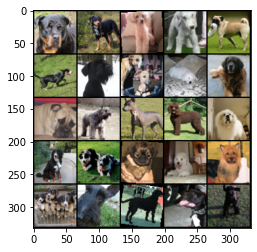

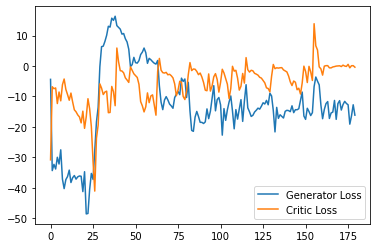

Step 3650: Generator loss: -17.408394527435302, critic loss: -0.14334295938412356


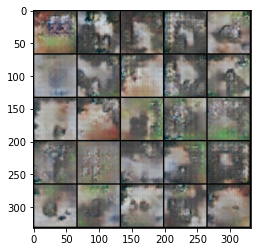

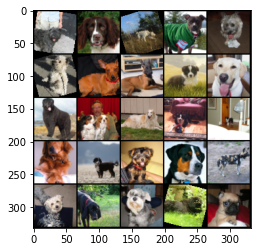

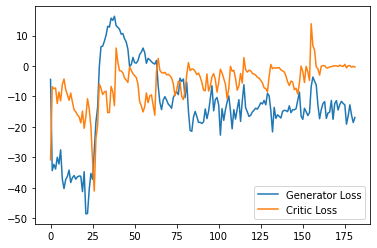

Step 3700: Generator loss: -16.469130668640137, critic loss: -0.5609258039792379


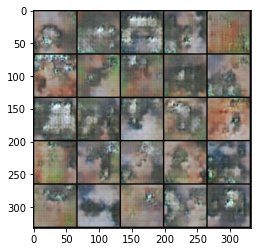

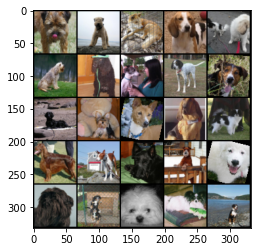

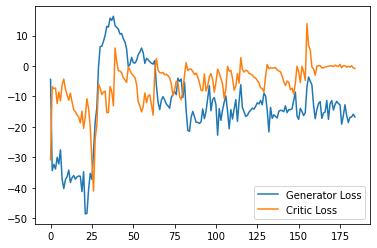

Step 3750: Generator loss: -17.231132068634032, critic loss: -0.3494995008409023


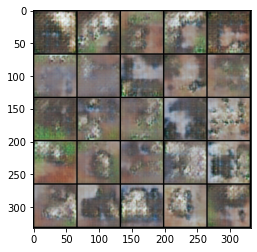

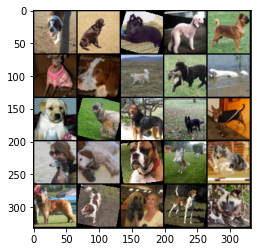

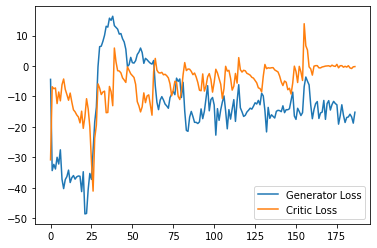

Step 3800: Generator loss: -20.857455368041993, critic loss: -0.2766063151756922


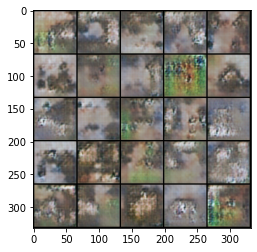

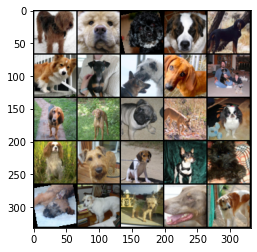

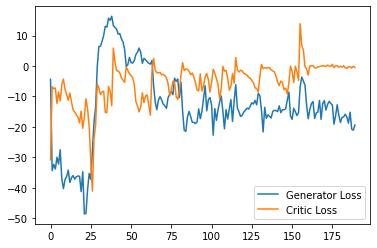

Step 3850: Generator loss: -17.852448692321776, critic loss: -0.4736874287327131


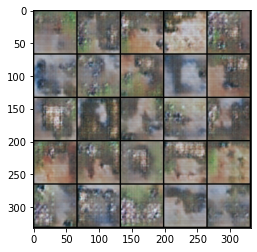

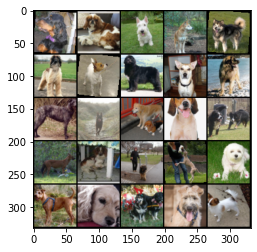

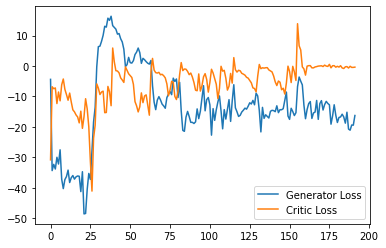

Step 3900: Generator loss: -19.6021773147583, critic loss: -0.24798744842410092


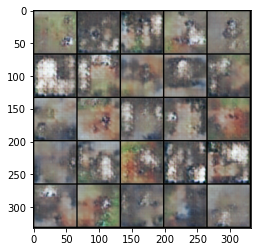

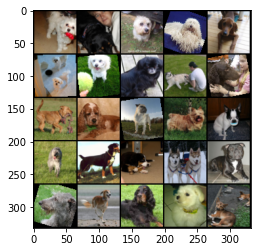

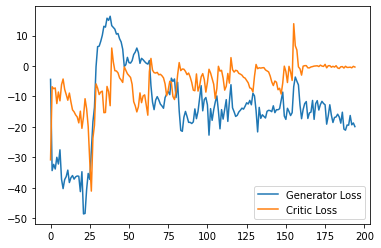

Step 3950: Generator loss: -21.414593982696534, critic loss: -0.724854413767656


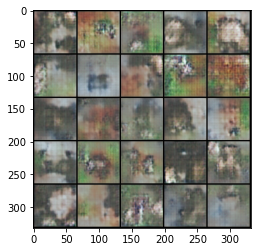

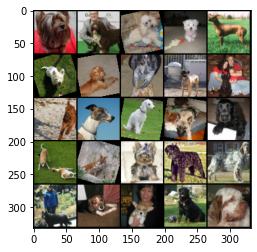

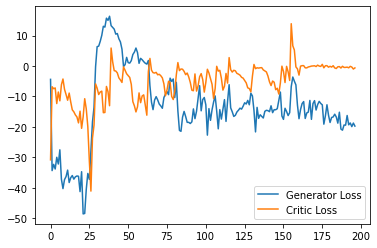

Step 4000: Generator loss: -20.746314239501952, critic loss: -0.706282668064038


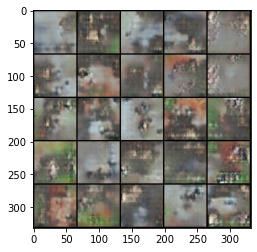

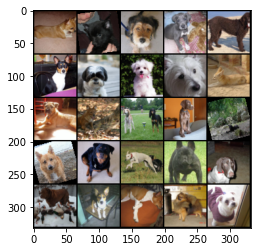

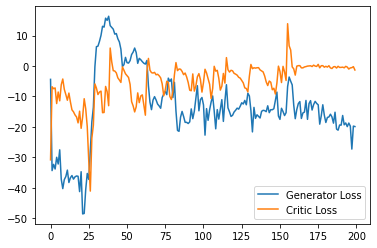

Step 4050: Generator loss: -19.826311111450195, critic loss: -0.5975623085598151


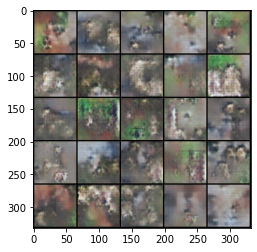

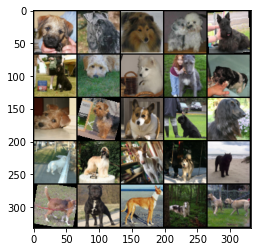

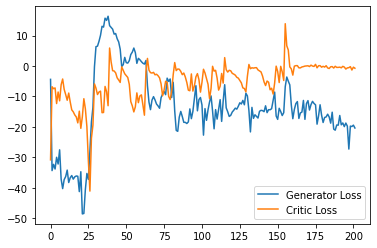

KeyboardInterrupt: 

In [23]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            #print(real.shape)
            #print(fake.shape)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()
            torch.save({
                'epoch': epoch,
                'gen_state_dict': gen.state_dict(),
                'gen_optimizer_state_dict': gen_opt.state_dict(),
                'crit_state_dict': crit.state_dict(),
                'crit_optimizer_state_dict': crit_opt.state_dict(),
                'gen_loss': gen_loss.item(),
                'crit_loss': crit_loss.item(),
                }, CHK_PT)

        cur_step += 1

In [27]:
import os
from torchvision.utils import save_image
if not os.path.exists('../output-images-wgan-v1/'):
    os.mkdir('../output-images-wgan-v1/')
    
im_batch_size = 50
n_images=500

for i_batch in tqdm(range(0, n_images, im_batch_size)):
    gen_z = torch.randn(im_batch_size, z_dim, 1, 1, device=device)
    gen_images = gen(gen_z)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    images
    for i_image in range(gen_images.size(0)):
        save_image((gen_images[i_image, :, :, :]+1.)/2., os.path.join('../output-images-wgan-v1/', f'image_{i_batch+i_image:05d}.png'))